### This notebook demonstrates three methods for step detection in 1D data:
1. Convolution with a derivative-of-gaussian wavelet
2. Multiscale product as described by [Mallat and Zhong](http://www.cmap.polytechnique.fr/~mallat/papiers/MallatEdgeCharact92.pdf), and as implemented by [Sadler and Swami](http://www.dtic.mil/dtic/tr/fulltext/u2/a351960.pdf).
3. The t-statistic method of [Carter and Cross](http://www.nature.com/nature/journal/v435/n7040/abs/nature03528.html)

### and demonstrates the usage of the algorithms provided in `step_detect.py`.

In [1]:
import numpy as np
import step_detect
from bokeh.plotting import figure, show
from bokeh.io import output_notebook, gridplot
from scipy.ndimage.filters import gaussian_filter1d

ModuleNotFoundError: No module named 'bokeh'


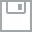
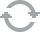
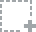
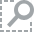
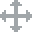
...
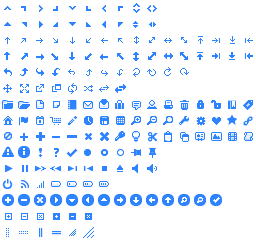
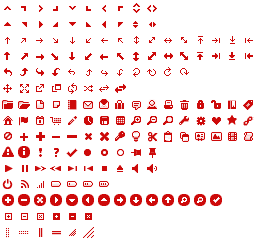
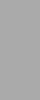
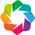
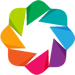

In [2]:
output_notebook()

### First, we will generate a test dataset.
We will use the same data set as that of [Sadler and Swami](http://ieeexplore.ieee.org/stamp/stamp.jsp?arnumber=761341), but scaled up in sampling.

In [3]:
def gen_data(A, sd, scaling):
    """
    Generates test data of the sort used by Sadler and Swami.
    Set sd to 0 for noise-free (ideal) data 
    """
    
    x = np.linspace(0, 500, 500*scaling)
    
    data = np.zeros_like(x)
    data[np.logical_and(x > 50, x < 150)] = 1
    data[np.logical_and(x > 200, x < 250)] = 1
    data[np.logical_and(x > 300, x < 310)] = 1
    data[np.logical_and(x > 360, x < 365)] = 1
    data[np.logical_and(x > 416, x < 417)] = 1
    data[np.logical_and(x > 442, x < 443)] = 1
    data[np.logical_and(x > 445, x < 446)] = 1
    data *= A
    if sd:
        data += np.random.normal(scale = sd, size=x.shape)
    

    return data, x

In [4]:
A       = 10  # amplitude of signal
sd      = 1   # sd of added Gaussian noise
scaling = 100 # scaling of sampling rate

data, x = gen_data(A, 1, scaling)

f = figure(width=950, height=200, y_range=[-0.5*A, 1.5*A])
f.line(x, data, color='navy')
show(f)

### Next, we calculate and plot each of the three metrics to see the response signal that they generate.

In [5]:
# Deritave of Gaussian wavelet convolution can be done with a SciPy function
dg1 = gaussian_filter1d(data, 20, order=1)
dg1 /= np.abs(dg1).max() # normalizing here to facillitate comparison despite vastly varying magnitudes
dg2 = gaussian_filter1d(data, 100, order=1)
dg2 /= np.abs(dg2).max()

# Multiscale product is calculated using mz_fwt (Mallat and Zhong Forward Wavelet Transform)
p2  = step_detect.mz_fwt(data, n=2)
p2 /= np.abs(p2).max()
p3  = step_detect.mz_fwt(data, n=3)
p3 /= np.abs(p3).max()

t1  = step_detect.t_scan(data, window=250)
t1 /= np.abs(t1).max()
t2  = step_detect.t_scan(data, window=500)
t2 /= np.abs(t2).max()

f1 = figure(width=950, height=200, y_range=[-0.5*A, 1.5*A], title='Input Data')
f2 = figure(width=950, height=200, x_range=f1.x_range, title='Derivative of Gaussian Wavelet Convolution')
f3 = figure(width=950, height=200, x_range=f1.x_range, title='Multiscale Product')
f4 = figure(width=950, height=200, x_range=f1.x_range, title='T-statistic Scan')

f1.line(x, data, color='navy')

f2.line(x, dg1, color='navy', legend='sigma = 20')
f2.line(x, dg2, color='firebrick', legend='sigma = 100')

f3.line(x, p2, color='navy', legend='p2')
f3.line(x, p3, color='firebrick', legend='p3')

f4.line(x, t1, color='navy', legend='window = 250 points')
f4.line(x, t2, color='firebrick', legend='window = 500 points')

f = gridplot([[f1], [f2], [f3], [f4]])
show(f)

### Let's take a closer look at one of the smaller pulses

In [6]:
f1 = figure(width=950, height=200, x_range=[298, 312], y_range=[-0.5*A, 1.5*A], title='Input Data')
f2 = figure(width=950, height=200, x_range=f1.x_range, title='Derivative of Gaussian Wavelet Convolution')
f3 = figure(width=950, height=200, x_range=f1.x_range, title='Multiscale Product')
f4 = figure(width=950, height=200, x_range=f1.x_range, title='T-statistic Scan')

f1.line(x, data, color='navy')

f2.line(x, dg1, color='navy', legend='sigma = 20')
f2.line(x, dg2, color='firebrick', legend='sigma = 100')

f3.line(x, p2, color='navy', legend='p2')
f3.line(x, p3, color='firebrick', legend='p3')

f4.line(x, t1, color='navy', legend='window = 250 points')
f4.line(x, t1, color='firebrick', legend='window = 500 points')

f = gridplot([[f1], [f2], [f3], [f4]])
show(f)

### The multiscale product has the sharpest localization to the step positions, though the t-statistic scan is also fairly sharp. Now let's see how these methods actually perform in terms of step identification (using a simple thresholding algorithm)...

In [7]:
# First, lets find the actual points which correspond to the steps in the (noise-free) ideal data
data, x = gen_data(A, 0, scaling)

steps = np.where(np.abs(np.diff(data)) == A)[0]
print steps.tolist()

[4999, 14999, 19999, 24999, 29999, 30999, 35999, 36499, 41599, 41699, 44199, 44299, 44499, 44599]


In [8]:
arrays = [
    
    dg1,
    dg2,
    p2,
    p3,
    t1,
    t2
    
]

for array in arrays:
    print step_detect.find_steps(np.abs(array), 0.5)

[4999, 14999, 19999, 24999, 29999, 31000, 35999, 36499, 41600, 41699, 44198, 44300, 44500, 44600]
[4998, 14997, 19999, 25000, 30000, 31000, 36000, 36499, 41544, 41754, 44145, 44653]
[4997, 14997, 19997, 24997, 29997, 30997, 35997, 41597, 41697, 44197, 44297, 44497, 44597]
[4997, 14997, 19997, 24997, 30997, 35997, 41597, 41697, 44197, 44297, 44497, 44597]
[5000, 15000, 20000, 25000, 30000, 31000, 36000, 36500]
[5000, 15000, 20000, 25000, 30000, 31000, 36000, 36500]


### The only method that captured all steps (included the double impulse at the end) was the lower-smoothing derivative of Gaussian wavelet method. However, this method is also the most susceptible to noise and may not be as useful in real-world applications. The t-statistic method fails to capture the smaller steps (and in general will do poorly for transient steps which are only occupied to time scales on the order of the window size. Decreasing window size can increase higher-frequency detection, but at the expense of greater noise susceptibility. The multiscale product method had the best performance for this particular data.

### We can use the `get_step_sizes()` function to calculate step sizes from the indices provided above:

In [9]:
step_sizes, step_error = step_detect.get_step_sizes(data, step_detect.find_steps(np.abs(dg1), 0.5), window=200)
print step_sizes

[9.9499999999999993, -9.9499999999999993, 9.9499999999999993, -9.9499999999999993, 9.9499999999999993, -10.0, 9.9499999999999993, -9.9499999999999993, 10.0, -9.8989898989898997, 9.8039215686274517, -9.8039215686274517, 10.0, -10.0]


### Note that the returned step sizes are are all roughly equal to `A`, and the the directionality of the step is preserved.